# Setup

In [14]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [15]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [16]:
import cv2
import matplotlib
import numpy as np
from matplotlib import pyplot as plt
import imageio

# Test

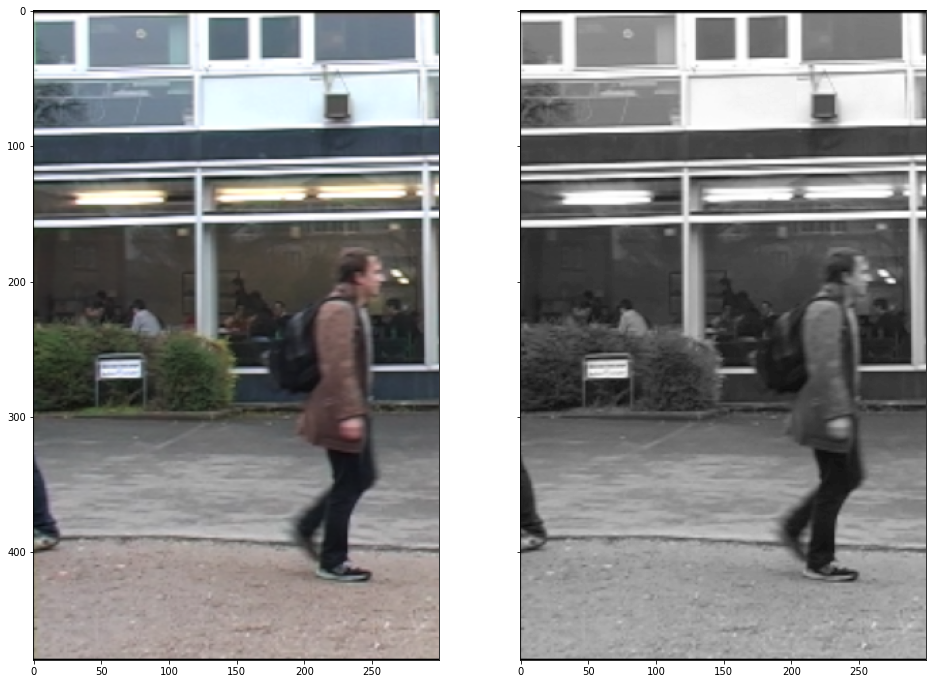

In [ ]:
# Load the image in color (OpenCV standard = BGR)
path = "/content/drive/MyDrive/6ª Fase/Reconhecimento de Padrões/Projeto/tud-campus-sequence/DaSide0811-seq6-143.png"

orig = cv2.imread(path, cv2.IMREAD_COLOR)
# Convert to RGB
orig = cv2.cvtColor(orig, cv2.COLOR_BGR2RGB)

# Load the image in grayscale
gray = cv2.imread(path, cv2.IMREAD_GRAYSCALE)

fig, axes = plt.subplots(1, 2, figsize=(16, 12), sharex=True, sharey=True)
ax = axes.ravel()
ax[0].imshow(orig[:, 0:300])
ax[1].imshow(gray[:, 0:300], 'gray')

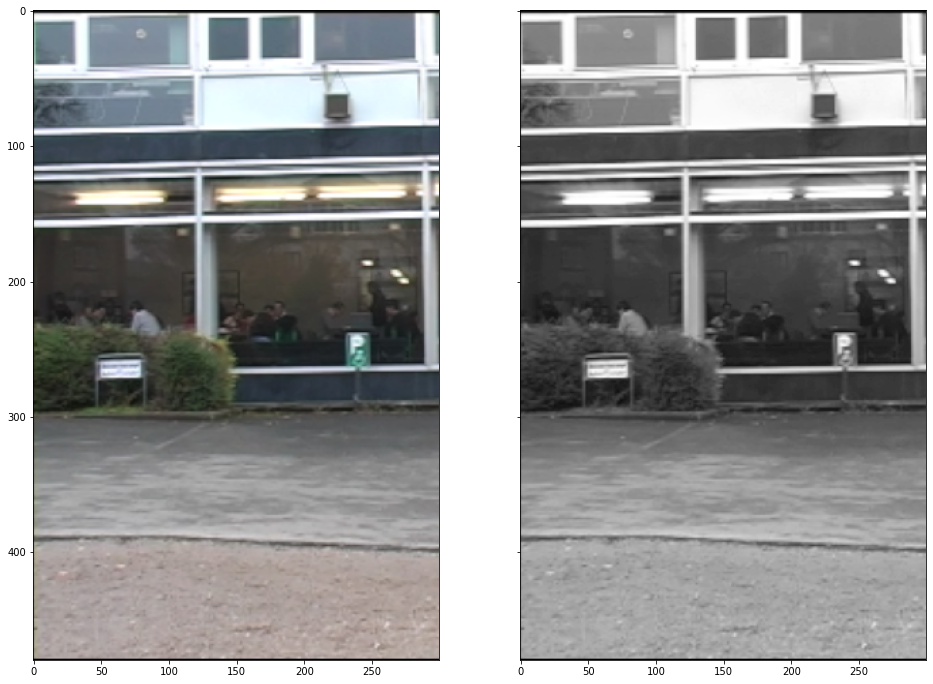

In [ ]:
# Load the image in color (OpenCV standard = BGR)
ref_orig = cv2.imread("/content/drive/MyDrive/6ª Fase/Reconhecimento de Padrões/Projeto/tud-campus-sequence/DaSide0811-seq6-160.png", cv2.IMREAD_COLOR)
# Convert to RGB
ref_orig = cv2.cvtColor(ref_orig, cv2.COLOR_BGR2RGB)

# Load the image in grayscale
ref_gray = cv2.imread("/content/drive/MyDrive/6ª Fase/Reconhecimento de Padrões/Projeto/tud-campus-sequence/DaSide0811-seq6-160.png", cv2.IMREAD_GRAYSCALE)

fig, axes = plt.subplots(1, 2, figsize=(16, 12), sharex=True, sharey=True)
ax = axes.ravel()
ax[0].imshow(ref_orig[:, 0:300])
ax[1].imshow(ref_gray[:, 0:300], 'gray')

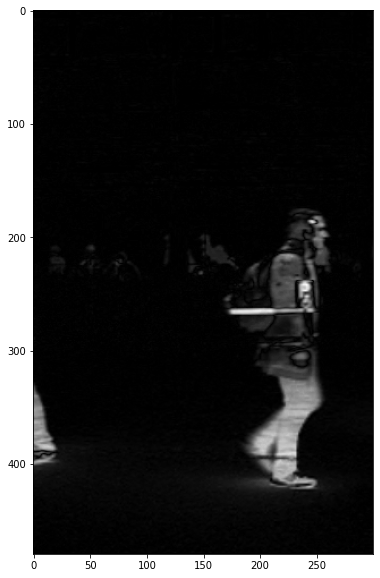

In [ ]:
# Calculate the absolute difference between two images
# Image order is irrelevant since we will discard the sign
change = cv2.absdiff(gray[:, 0:300], ref_gray[:, 0:300])
# Set the size to show
plt.figure(figsize = (12,10))
# Show it!
plt.imshow(change, 'gray')

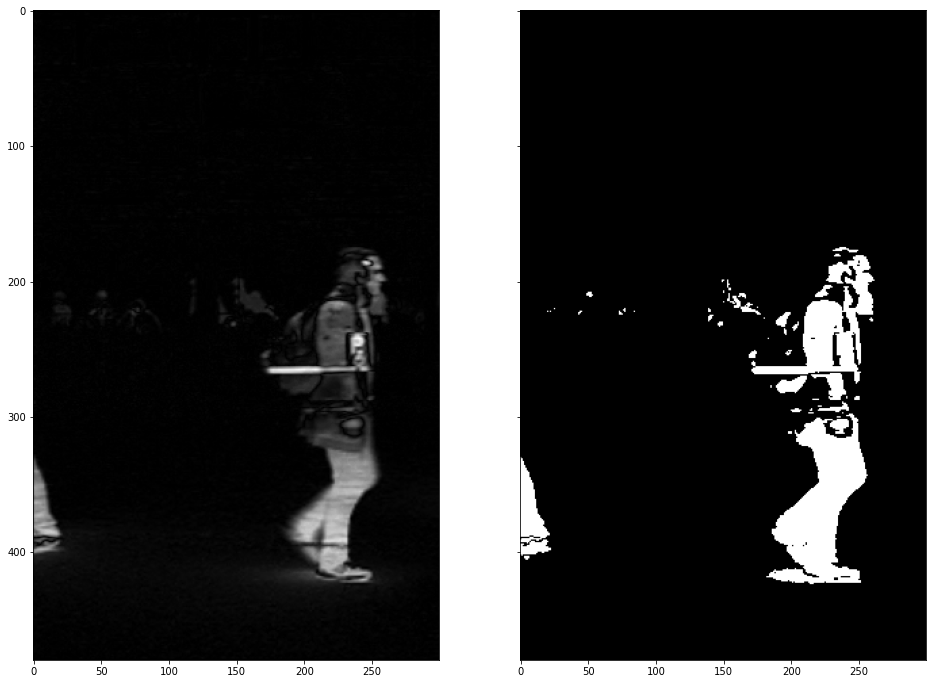

In [ ]:
modes = ['cv2.THRESH_BINARY', 'cv2.THRESH_BINARY_INV', 'cv2.THRESH_TRUNC', 'cv2.THRESH_TOZERO', 'cv2.THRESH_TOZERO_INV']

# Basic threshold example
def my_threshold(thresh, modeStr):
    global change
    global dst
    mode = eval(modeStr)
    th, dst = cv2.threshold(change, thresh, 255, mode)
    fig, axes = plt.subplots(1, 2, figsize=(16, 12), sharex=True, sharey=True)
    ax = axes.ravel()
    ax[0].imshow(change,'gray')
    ax[1].imshow(dst,'gray')

# If your using Google Colab, comment the line above and use this here...
my_threshold(25, 'cv2.THRESH_BINARY')

In [ ]:
kernel_opening = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (6, 6))
print(kernel_opening)

[[0 0 0 1 0 0]
 [0 1 1 1 1 1]
 [1 1 1 1 1 1]
 [1 1 1 1 1 1]
 [1 1 1 1 1 1]
 [0 1 1 1 1 1]]


In [ ]:
kernel_closing = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (30, 60))
print(kernel_closing)

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


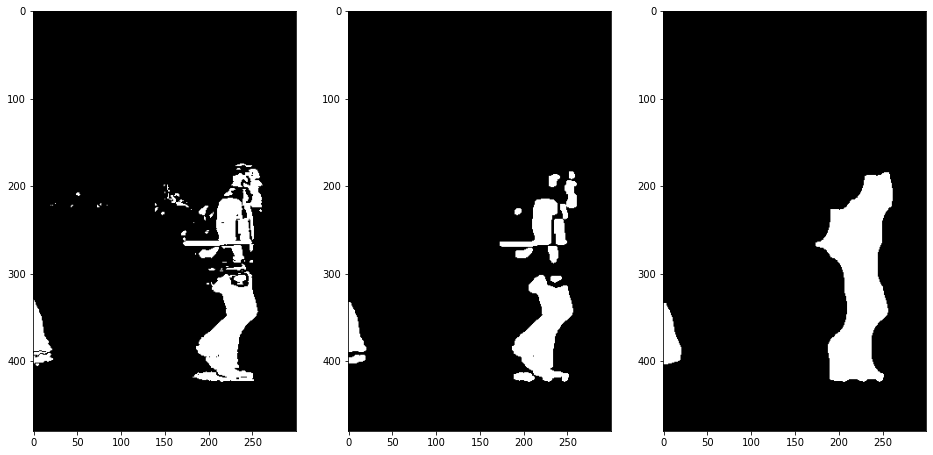

In [ ]:
opening = cv2.morphologyEx(dst, cv2.MORPH_OPEN, kernel_opening)
closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel_closing)
# Set the size to show
fig, axes = plt.subplots(1, 3, figsize=(16, 12), sharex = False, sharey = False)
ax = axes.ravel()
ax[0].imshow(dst, 'gray')
ax[1].imshow(opening,'gray')
ax[2].imshow(closing,'gray')

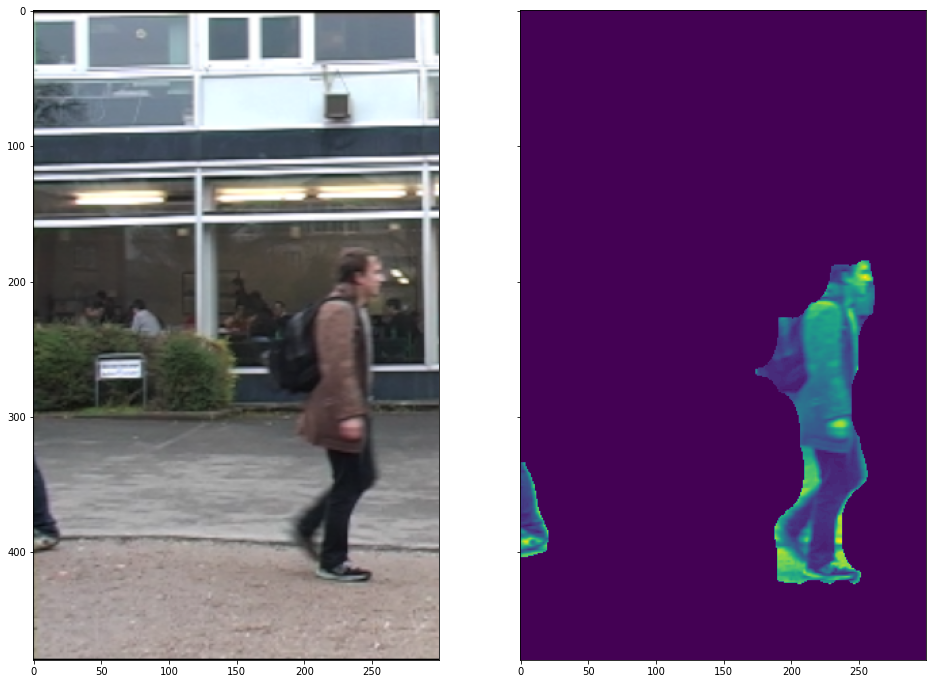

In [ ]:
masked_with_morpho = cv2.multiply(gray[:, 0:300], (closing//255))
# Set the size to show
fig, axes = plt.subplots(1, 2, figsize=(16, 12), sharex=True, sharey=True)
ax = axes.ravel()
ax[0].imshow(orig[:, 0:300])
ax[1].imshow(masked_with_morpho)

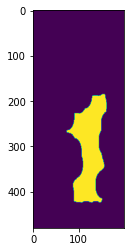

In [ ]:
plt.imshow(closing[:, 100:300])

123 305


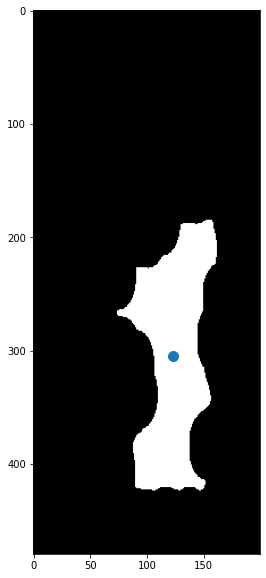

In [ ]:
# convert the grayscale image to binary image
ret, thresh = cv2.threshold(closing[:, 100:300], 127, 255, 0)

# calculate moments of binary image
M = cv2.moments(thresh)

# calculate x,y coordinate of center
cX = int(M["m10"] / M["m00"])
cY = int(M["m01"] / M["m00"])

print(cX, cY)

# Set the size to show
plt.figure(figsize = (12,10))
# Show it!
plt.imshow(closing[:, 100:300], 'gray')
plt.scatter(cX, cY, s = 100)

Connected Component Labeling

In [ ]:
def connected_component_label(img):
    
    # Getting the input image
    # img = cv2.imread(path, 0)
    # Converting those pixels with values 1-127 to 0 and others to 1
    # img = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)[1]
    # Applying cv2.connectedComponents() 
    num_labels, labels = cv2.connectedComponents(img)

    
    # Map component labels to hue val, 0-179 is the hue range in OpenCV
    label_hue = np.uint8(179*labels/np.max(labels))
    blank_ch = 255*np.ones_like(label_hue)
    labeled_img = cv2.merge([label_hue, blank_ch, blank_ch])

    # Converting cvt to BGR
    labeled_img = cv2.cvtColor(labeled_img, cv2.COLOR_HSV2BGR)

    # set bg label to black
    labeled_img[label_hue==0] = 0
    
    # Showing Original Image
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title("Orginal Image")
    plt.show()
    
    #Showing Image after Component Labeling
    plt.imshow(cv2.cvtColor(labeled_img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title("Image after Component Labeling")
    plt.show()

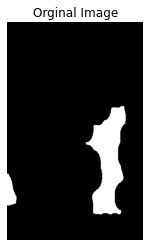

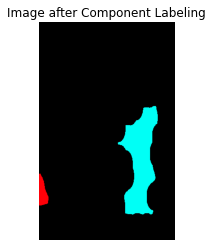

In [ ]:
connected_component_label(closing)

# Classic

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:33: RuntimeWarning: invalid value encountered in true_divide


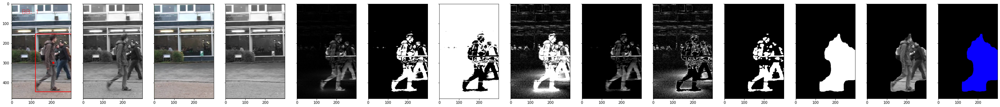

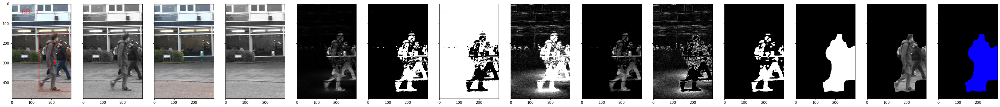

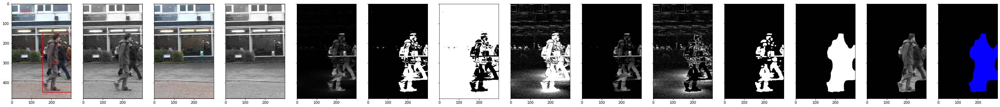

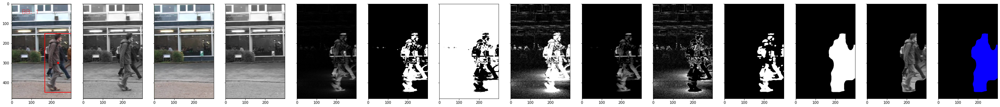

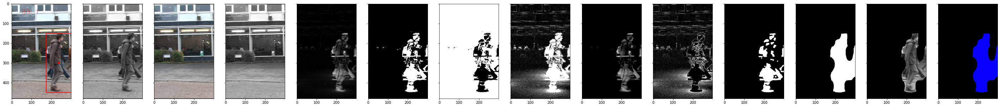

...

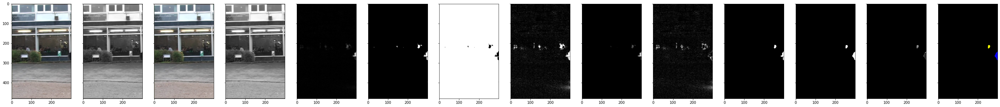

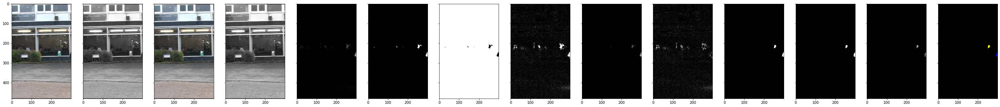

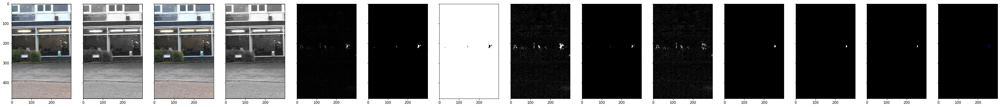

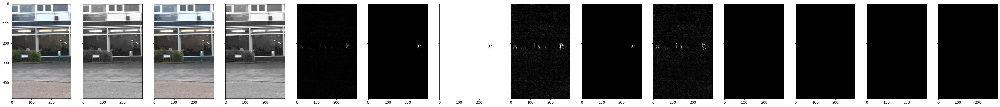

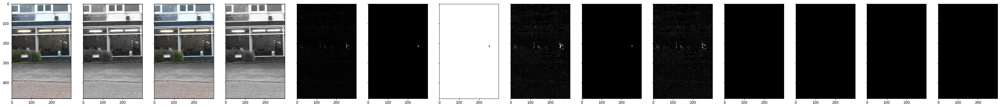

In [30]:
def classic(path, path_orig):

  orig = cv2.imread(path, cv2.IMREAD_COLOR)
  orig = cv2.cvtColor(orig, cv2.COLOR_BGR2RGB)
  gray = cv2.imread(path, cv2.IMREAD_GRAYSCALE)

  ref_orig = cv2.imread(path_orig, cv2.IMREAD_COLOR)
  ref_orig = cv2.cvtColor(ref_orig, cv2.COLOR_BGR2RGB)
  ref_gray = cv2.imread(path_orig, cv2.IMREAD_GRAYSCALE)

  change = cv2.absdiff(gray[:, 0:300], ref_gray[:, 0:300])

  modes = ['cv2.THRESH_BINARY', 'cv2.THRESH_BINARY_INV', 'cv2.THRESH_TRUNC', 'cv2.THRESH_TOZERO', 'cv2.THRESH_TOZERO_INV']

  thresh = 25

  ret, thresh1 = cv2.threshold(change, thresh, 255, eval(modes[0]))
  ret, thresh2 = cv2.threshold(change, thresh, 255, eval(modes[1]))
  ret, thresh3 = cv2.threshold(change, thresh, 255, eval(modes[2]))
  ret, thresh4 = cv2.threshold(change, thresh, 255, eval(modes[3]))
  ret, thresh5 = cv2.threshold(change, thresh, 255, eval(modes[4]))

  kernel_opening = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (6, 6))
  kernel_closing = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (30, 60))

  opening = cv2.morphologyEx(thresh1, cv2.MORPH_OPEN, kernel_opening)
  closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel_closing)

  masked = cv2.multiply(gray[:, 0:300], (closing//255))

  num_labels, labels = cv2.connectedComponents(closing)

  label_hue = np.uint8(179*labels/np.max(labels))
  blank_ch = 255*np.ones_like(label_hue)
  labeled = cv2.merge([label_hue, blank_ch, blank_ch])

  labeled = cv2.cvtColor(labeled, cv2.COLOR_HSV2BGR)

  labeled[label_hue==0] = 0

  centers = {}

  red = (255, 0, 0)

  cnts = cv2.findContours(closing, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
  cnts = cnts[0] if len(cnts) == 2 else cnts[1]

  for c in cnts:
    x, y, w, h = cv2.boundingRect(c)
    bbox = (x, y, w, h)
    p1 = (int(bbox[0]), int(bbox[1]))
    p2 = (int(bbox[0] + bbox[2]), int(bbox[1] + bbox[3]))
    if w > 50 or h > 50:
      cv2.putText(orig[:, 0:300], "BB: " + str(len(cnts)), (50, 50), cv2.FONT_HERSHEY_SIMPLEX, 1, red, 1, cv2.LINE_4)
      orig[:, 0:300] = cv2.rectangle(orig[:, 0:300], p1, p2, red, 2, 1)
      center = (int(x + w/2), int(y + h/2))
      orig[:, 0:300] = cv2.circle(orig[:, 0:300], center, radius=0, color=red, thickness=10)

  print_all = True

  if print_all == True:
    fig, axes = plt.subplots(1, 14, figsize=(50, 50), sharex = True, sharey = True)
    ax = axes.ravel()
    ax[0].imshow(orig[:, 0:300])
    ax[1].imshow(gray[:, 0:300], 'gray')
    ax[2].imshow(ref_orig[:, 0:300])
    ax[3].imshow(ref_gray[:, 0:300], 'gray')
    ax[4].imshow(change, 'gray')
    ax[5].imshow(thresh1, 'gray')
    ax[6].imshow(thresh2, 'gray')
    ax[7].imshow(thresh3, 'gray')
    ax[8].imshow(thresh4, 'gray')
    ax[9].imshow(thresh5, 'gray')
    ax[10].imshow(opening, 'gray')
    ax[11].imshow(closing, 'gray')
    ax[12].imshow(masked, 'gray')
    ax[13].imshow(labeled)
  else:
    fig, axes = plt.subplots(1, 2, figsize=(50, 50), sharex = True, sharey = True)
    ax = axes.ravel()
    ax[0].imshow(labeled)
    ax[1].imshow(orig[:, 0:300])

  return np.concatenate((gray[:, 0:300], change, thresh1, opening, closing, masked, labeled[:, :, 0]), axis = 1)

image_list = []

for i in range(100, 160):
  path = "/content/drive/MyDrive/6ª Fase/Reconhecimento de Padrões/Projeto/tud-campus-sequence/DaSide0811-seq6-"+ str(i) +".png"
  path_orig = "/content/drive/MyDrive/6ª Fase/Reconhecimento de Padrões/Projeto/tud-campus-sequence/DaSide0811-seq6-160.png"
  detection = classic(path, path_orig)
  image_list.append(detection)
imageio.mimsave('/content/video.gif', image_list, fps=15)